# Computer Vision Analysis

Copyright 2023

Table of contents:

1.Installing, importing  
2.Downloading Validation set  
3.Classification with Google Cloud Vision   
4.Classification with HuggingGPT
  Model chaining with Google Cloud AI to OpenAI ChatGPT, GPT-4    
5.Model chaining with Gen-2 by Runway

# 1.Installing, importing

In [ ]:
!pip install moviepy -qq

In [ ]:
from IPython.display import Image     #This is used for rendering images in the notebook

In [ ]:
import json

In [ ]:
import pandas as pd

In [ ]:
#Development access to delete when going into production
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# 2.Validation set

## Level 1 image: easy

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter16/generate_an_image_of_a_car_in_space.jpg --output "generate_an_image_of_a_car_in_space.jpg"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 32209  100 32209    0     0   143k      0 --:--:-- --:--:-- --:--:--  142k


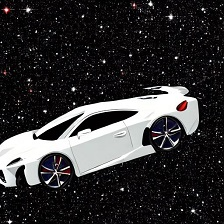

In [ ]:
from PIL import Image
# Define the path of your image
image_path = "/content/generate_an_image_of_a_car_in_space.jpg"
# Open the image
image = Image.open(image_path)
image

## Level 2 image: difficult

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter18/car_in_night.jpg --output "car_in_night.jpg"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 17428  100 17428    0     0  88054      0 --:--:-- --:--:-- --:--:-- 88467


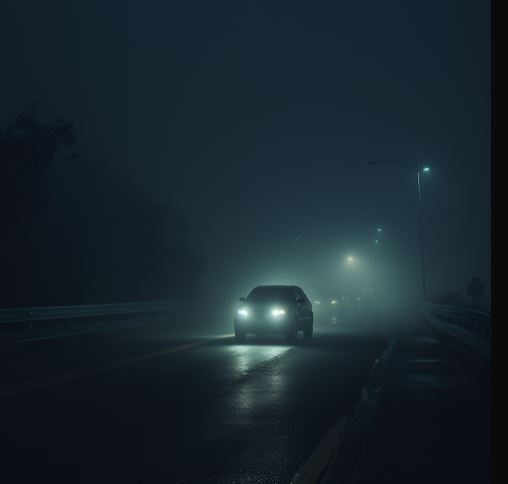

In [ ]:
from PIL import Image
# Define the path of your image
image_path = "/content/car_in_night.jpg"
# Open the image
image = Image.open(image_path)
image

## Level 3 image: very difficult

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter18/car_in_fog.png --output "car_in_fog.png"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  586k  100  586k    0     0  1666k      0 --:--:-- --:--:-- --:--:-- 1665k


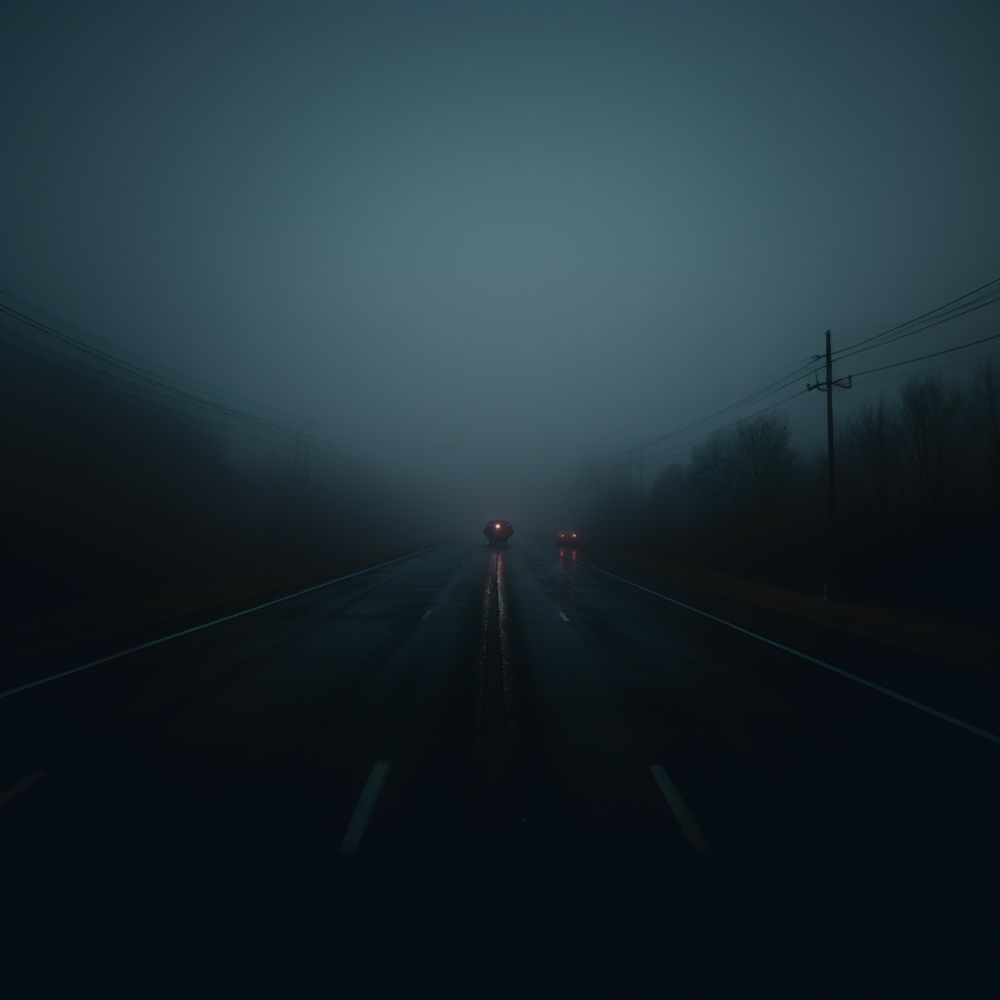

In [ ]:
image_path = "car_in_fog.png"
image = Image.open(image_path)
image

# 4.HuggingGPT

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers-for-NLP-and-Computer-Vision-3rd-Edition/main/Notebook%20images/19/HuggingGPT.jpg --output "HuggingGPT.jpg"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  109k  100  109k    0     0   379k      0 --:--:-- --:--:-- --:--:--  380k


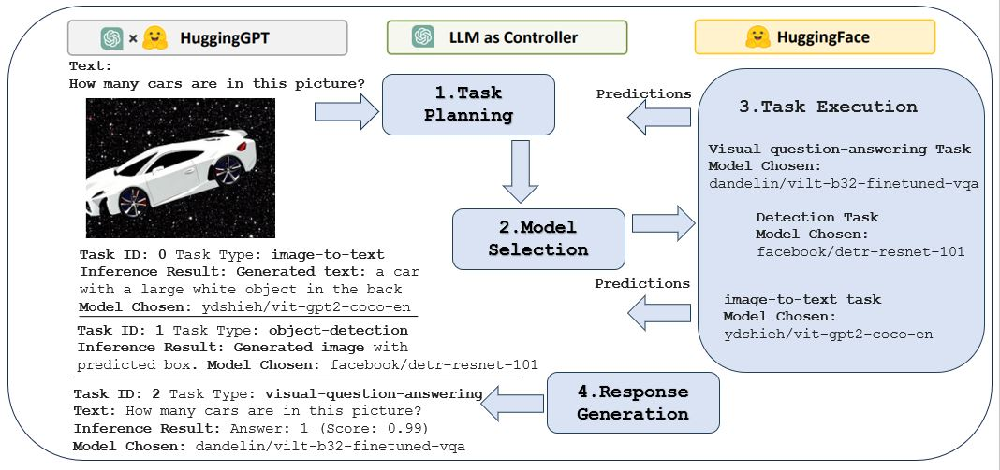

In [ ]:
image_path = "/content/HuggingGPT.jpg"
image = Image.open(image_path)
image

## Level 1 : easy

generate_an_image_of_a_car_in_space.jpg

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/HGPT1.json --output "HGPT1.json"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  1843  100  1843    0     0   9190      0 --:--:-- --:--:-- --:--:--  9169


In [ ]:
with open("HGPT1.json") as f:
    data = json.load(f)

# Extract and Print the tasks and their details
for key, value in data.items():
    print(f"Task ID: {value['task']['id']}")
    print(f"Task Type: {value['task']['task']}")
    print(f"Dependencies: {', '.join(map(str, value['task']['dep']))}")

    if 'args' in value['task']:
        for arg_key, arg_value in value['task']['args'].items():
            print(f"   {arg_key.capitalize()}: {arg_value}")

    # Extract and Print the inference results
    if 'inference result' in value:
        print("Inference Result:")
        if isinstance(value['inference result'], dict):
            for result_key, result_value in value['inference result'].items():
                print(f"   {result_key.capitalize()}: {result_value}")
        else:  # In case it's a list like in the visual-question-answering task
            for item in value['inference result']:
                print(f"   Answer: {item['answer']} (Score: {item['score']})")

    # Extract and Print the model used and the reason
    if 'choose model result' in value:
        print(f"Model Chosen: {value['choose model result']['id']}")
        print(f"Reason: {value['choose model result']['reason']}")

    print('-' * 50)  # A separator line for better readability

Task ID: 0
Task Type: image-to-text
Dependencies: -1
   Image: https://i.postimg.cc/nrKJ3jGK/generate-an-image-of-a-car-in-space.jpg
Inference Result:
   Generated text: a car with a large white object in the back 
Model Chosen: ydshieh/vit-gpt2-coco-en
Reason: Only one model available.
--------------------------------------------------
Task ID: 1
Task Type: object-detection
Dependencies: -1
   Image: https://i.postimg.cc/nrKJ3jGK/generate-an-image-of-a-car-in-space.jpg
Inference Result:
   Generated image with predicted box: /images/a7fd.jpg
   Predicted: []
Model Chosen: facebook/detr-resnet-101
Reason: Only one model available.
--------------------------------------------------
Task ID: 2
Task Type: visual-question-answering
Dependencies: 1
   Image: https://i.postimg.cc/nrKJ3jGK/generate-an-image-of-a-car-in-space.jpg
   Text: How many cars are in this picture?
Inference Result:
   Answer: 1 (Score: 0.9962437152862549)
   Answer: 0 (Score: 0.017030367627739906)
   Answer: 2 (Score:

## Level 2 : difficult

car_in_night.jpg

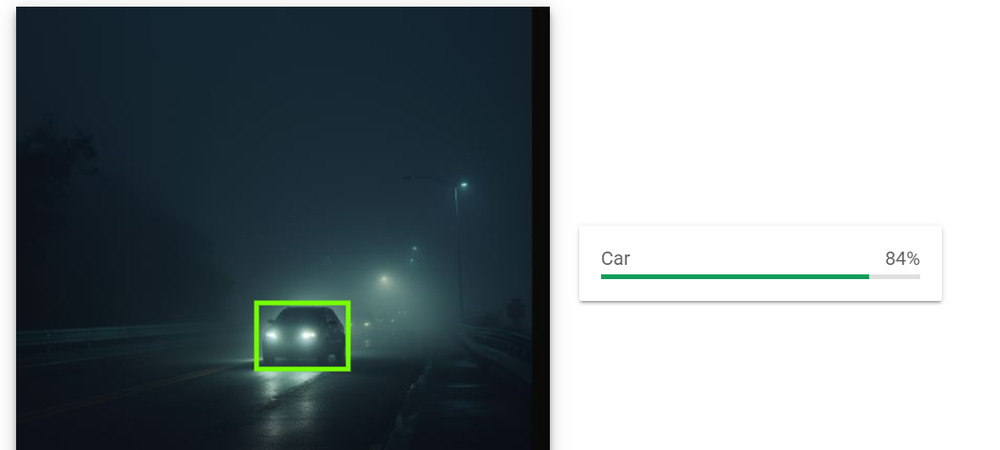

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/HGPT2.json --output "HGPT2.json"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  2016  100  2016    0     0  12260      0 --:--:-- --:--:-- --:--:-- 12292


In [ ]:
with open("HGPT2.json") as f:
    data = json.load(f)

# Extract and Print the tasks and their details
for key, value in data.items():
    print(f"Task ID: {value['task']['id']}")
    print(f"Task Type: {value['task']['task']}")
    print(f"Dependencies: {', '.join(map(str, value['task']['dep']))}")

    if 'args' in value['task']:
        for arg_key, arg_value in value['task']['args'].items():
            print(f"   {arg_key.capitalize()}: {arg_value}")

    # Extract and Print the inference results
    if 'inference result' in value:
        print("Inference Result:")
        if isinstance(value['inference result'], dict):
            for result_key, result_value in value['inference result'].items():
                print(f"   {result_key.capitalize()}: {result_value}")
        else:  # In case it's a list like in the visual-question-answering task
            for item in value['inference result']:
                print(f"   Answer: {item['answer']} (Score: {item['score']})")

    # Extract and Print the model used and the reason
    if 'choose model result' in value:
        print(f"Model Chosen: {value['choose model result']['id']}")
        print(f"Reason: {value['choose model result']['reason']}")

    print('-' * 50)  # A separator line for better readability

Task ID: 0
Task Type: image-to-text
Dependencies: -1
   Image: https://i.postimg.cc/sXp9xsJH/car-in-night.jpg
Inference Result:
   Generated text: a car is driving down a street at night 
Model Chosen: ydshieh/vit-gpt2-coco-en
Reason: Only one model available.
--------------------------------------------------
Task ID: 1
Task Type: object-detection
Dependencies: -1
   Image: https://i.postimg.cc/sXp9xsJH/car-in-night.jpg
Inference Result:
   Generated image with predicted box: /images/7953.jpg
   Predicted: [{'score': 0.9988002777099609, 'label': 'car', 'box': {'xmin': 232, 'ymin': 284, 'xmax': 314, 'ymax': 343}}]
Model Chosen: facebook/detr-resnet-101
Reason: Only one model available.
--------------------------------------------------
Task ID: 2
Task Type: visual-question-answering
Dependencies: 1
   Image: https://i.postimg.cc/sXp9xsJH/car-in-night.jpg
   Text: Is there a car in this picture?
Inference Result:
   Answer: yes (Score: 0.9839207530021667)
   Answer: no (Score: 0.1481371

## Level 3 : very difficult

car_in_fog.jpg

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/HGPT3.json --output "HGPT3.json"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  1768  100  1768    0     0   7539      0 --:--:-- --:--:-- --:--:--  7555


In [ ]:
with open("HGPT3.json") as f:
    data = json.load(f)

# Extract and Print the tasks and their details
for key, value in data.items():
    print(f"Task ID: {value['task']['id']}")
    print(f"Task Type: {value['task']['task']}")
    print(f"Dependencies: {', '.join(map(str, value['task']['dep']))}")

    if 'args' in value['task']:
        for arg_key, arg_value in value['task']['args'].items():
            print(f"   {arg_key.capitalize()}: {arg_value}")

    # Extract and Print the inference results
    if 'inference result' in value:
        print("Inference Result:")
        if isinstance(value['inference result'], dict):
            for result_key, result_value in value['inference result'].items():
                print(f"   {result_key.capitalize()}: {result_value}")
        else:  # In case it's a list like in the visual-question-answering task
            for item in value['inference result']:
                print(f"   Answer: {item['answer']} (Score: {item['score']})")

    # Extract and Print the model used and the reason
    if 'choose model result' in value:
        print(f"Model Chosen: {value['choose model result']['id']}")
        print(f"Reason: {value['choose model result']['reason']}")

    print('-' * 50)  # A separator line for better readability

Task ID: 0
Task Type: image-to-text
Dependencies: -1
   Image: https://i.postimg.cc/brp02WCy/car-in-fog.png
Inference Result:
   Generated text: a dark night with a light on a street 
Model Chosen: ydshieh/vit-gpt2-coco-en
Reason: Only one model available.
--------------------------------------------------
Task ID: 1
Task Type: object-detection
Dependencies: -1
   Image: https://i.postimg.cc/brp02WCy/car-in-fog.png
Inference Result:
   Generated image with predicted box: /images/0a15.jpg
   Predicted: []
Model Chosen: facebook/detr-resnet-101
Reason: Only one model available.
--------------------------------------------------
Task ID: 2
Task Type: visual-question-answering
Dependencies: 1
   Image: https://i.postimg.cc/brp02WCy/car-in-fog.png
   Text: Is there a car in this image?
Inference Result:
   Answer: no (Score: 0.9993352293968201)
   Answer: yes (Score: 0.019275549799203873)
   Answer: 0 (Score: 0.0007861475460231304)
   Answer: nowhere (Score: 0.000450292369350791)
   Answer:

DR:Please generate a better image based on car_in_fog.jpg

HuggingGPT:
"Based on the inference results, I have generated a better image for you. "

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/HGPT3_B.jpg --output "HGPT3_B.jpg"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 32119  100 32119    0     0   143k      0 --:--:-- --:--:-- --:--:--  143k


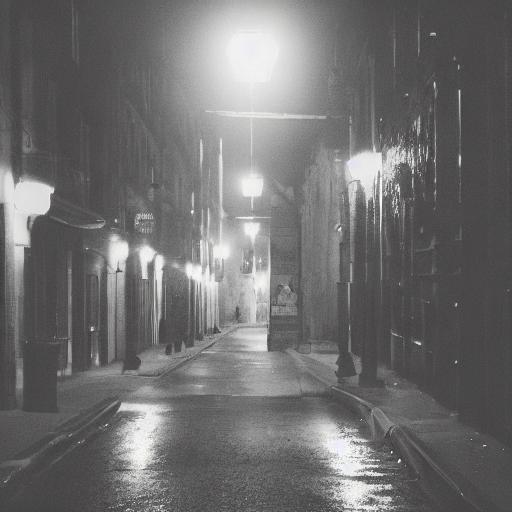

In [ ]:
from PIL import Image
# Define the path of your image
image_path = "/content/HGPT3_B.jpg"
# Open the image
image = Image.open(image_path)
image

# 3.CustomGPT

Cross-platform model chaining

Asking ChatGPT to analyze the output of Google Cloud Vision for the very difficult car in the fog image.

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers-for-NLP-and-Computer-Vision-3rd-Edition/main/Notebook%20images/19/CustomGPT.JPG --output "CustomGPT.JPG"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 95307  100 95307    0     0   358k      0 --:--:-- --:--:-- --:--:--  359k


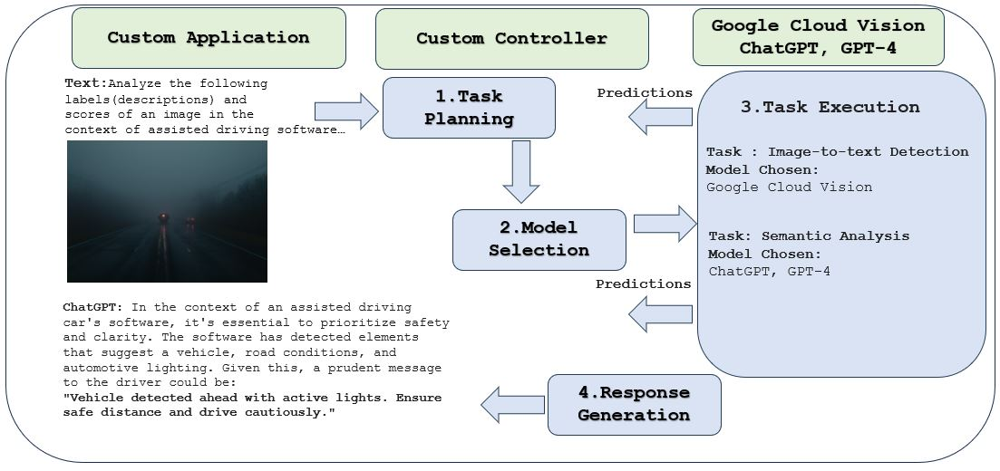

In [ ]:
image_path = "/content/CustomGPT.JPG"
image = Image.open(image_path)
image

## 3.1.Google Cloud Vision

[Online interface](https://cloud.google.com/vision/docs/drag-and-drop)

### Level 1 : easy

generate_an_image_of_a_car_in_space.jpg

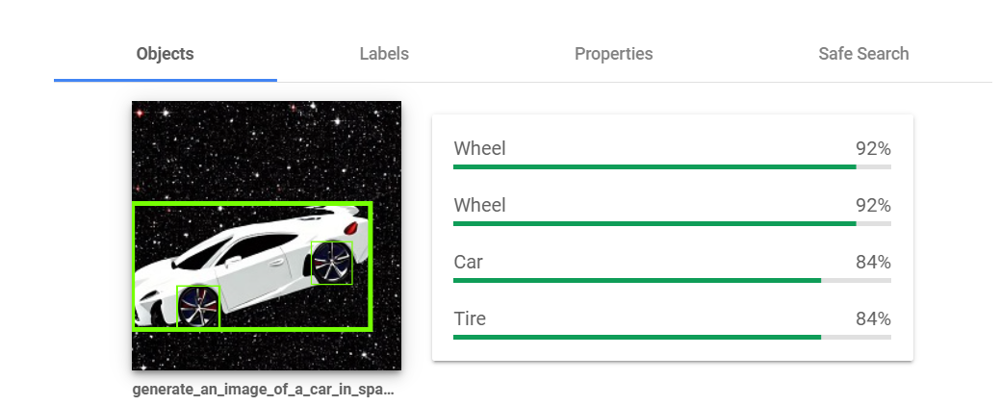

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/GCV.json --output "GCV.json"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 15292  100 15292    0     0  54320      0 --:--:-- --:--:-- --:--:-- 54226


In [ ]:
with open("GCV.json") as f:
    data = json.load(f)

labels = []
for label in data["labelAnnotations"]:
    labels.append([label["description"], label["score"]])

df = pd.DataFrame(labels, columns=["description", "score"])
df

,description,score
0,Wheel,0.969944
1,Tire,0.966153
2,Vehicle,0.956403
3,Car,0.942123
4,Hood,0.918258
5,Automotive parking light,0.917619
6,Automotive lighting,0.906899
7,Automotive tire,0.898249
8,Black,0.895158
9,Automotive design,0.879315


###Level 2 : difficult

car_in_night.jpg

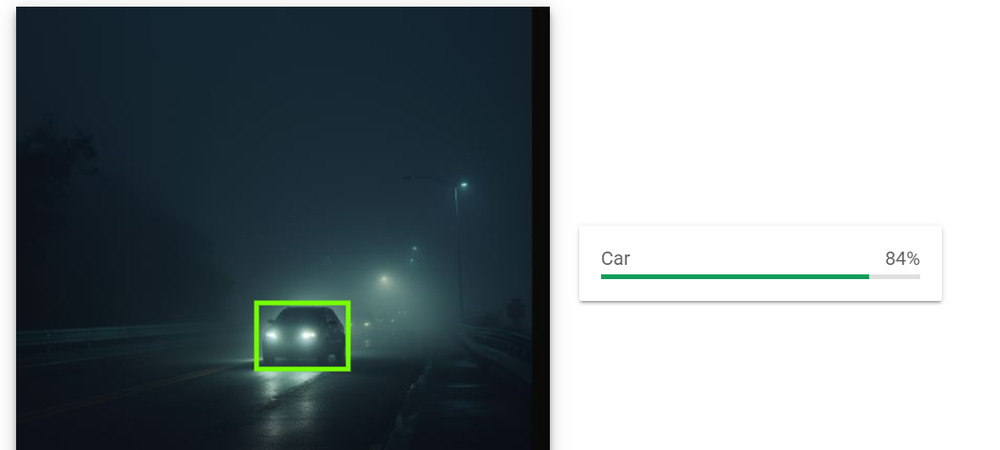

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/GCV2.json --output "GCV2.json"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 13541  100 13541    0     0  57163      0 --:--:-- --:--:-- --:--:-- 57377


In [ ]:
import json

with open("GCV2.json") as f:
    data = json.load(f)

labels = []
for label in data["labelAnnotations"]:
    labels.append([label["description"], label["score"]])

df = pd.DataFrame(labels, columns=["description", "score"])
df

,description,score
0,Car,0.954816
1,Vehicle,0.938368
2,Automotive lighting,0.923168
3,Road surface,0.878716
4,Asphalt,0.869295
5,Automotive design,0.864141
6,Headlamp,0.860162
7,Automotive mirror,0.827779
8,Automotive exterior,0.824365
9,Motor vehicle,0.809984


### Level 3 : very difficult

car_in_fog.jpg

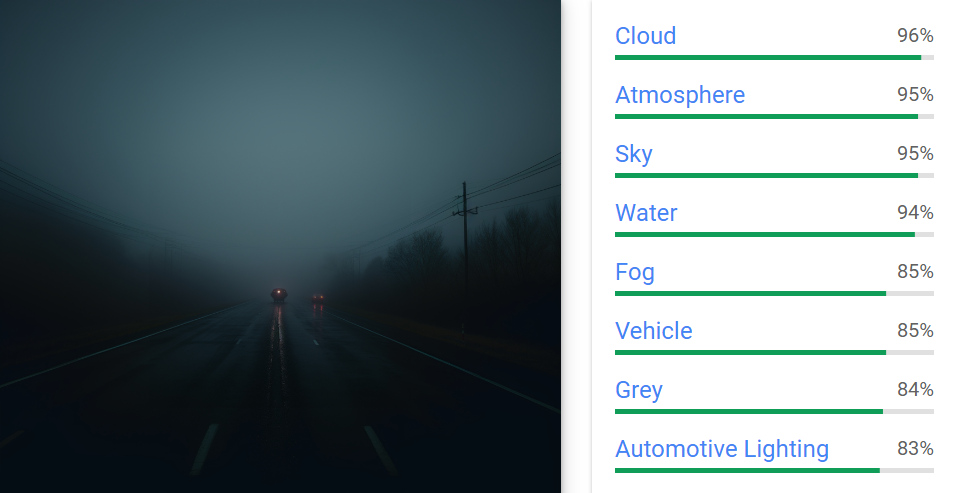

In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/GCV3.json --output "GCV3.json"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 15306  100 15306    0     0  59406      0 --:--:-- --:--:-- --:--:-- 59556


In [ ]:
import json

with open("GCV3.json") as f:
    data = json.load(f)

labels = []
for label in data["labelAnnotations"]:
    labels.append([label["description"], label["score"]])

df = pd.DataFrame(labels, columns=["description", "score"])
df

,description,score
0,Cloud,0.957413
1,Atmosphere,0.948181
2,Sky,0.945039
3,Water,0.938452
4,Fog,0.850576
5,Vehicle,0.848766
6,Grey,0.841551
7,Automotive lighting,0.831509
8,Atmospheric phenomenon,0.830896
9,Electricity,0.829284


## 3.2.ChatGPT, GPT-4

DR 1.Analyze the following labels(descriptions) and scores of an image. 2.Extract all the labels that are related to vehicles and roads that exceed a score of 0.8  3.Determine if there is a car in the image or not. Here are the labels and scores:
description	score   
0	Cloud	0.957413   
1	Atmosphere	0.948181   
2	Sky	0.945039  
3	Water	0.938452  
4	Fog	0.850576   
5	Vehicle	0.848766  
6	Grey	0.841551  
7	Automotive lighting	0.831509  
8	Atmospheric phenomenon	0.830896   
9	Electricity	0.829284   
10	Road surface	0.814302   
11	Landscape	0.764860   
12	Dusk	0.758024  
13	Track	0.752574   
14	Horizon	0.746588   
15	Asphalt	0.744103   
16	Haze	0.730276  
17	Road	0.724686  
18	Mist	0.716356   
19	Midnight	0.716127   
20	Overhead power line	0.684156   
21	Darkness	0.682619   
22	Tree	0.677585   
23	Public utility	0.661300   
24	Nonbuilding structure	0.642936   
25	Evening	0.640874   
26	Dawn	0.637772   
27	Symmetry	0.615672   
28	Natural landscape	0.612960   
29	Ocean	0.603301   
30	Freeway	0.602228   
31	Highway	0.601216   
32	Lane	0.587314  
33	Night	0.576490  
34	Monochrome	0.556066   
35	Lens flare	0.555109   
36	Road trip	0.527954   
37	Electrical supply	0.505197   


ChatGPT, GPT-4:

Firstly, let's analyze the given labels and scores:

1. From the list, labels that can be related to vehicles and roads are:
   - Vehicle
   - Automotive lighting
   - Road surface
   - Track
   - Asphalt
   - Road
   - Freeway
   - Highway
   - Lane
   - Road trip

2. To extract all the labels that are related to vehicles and roads that exceed a score of 0.8 and list them:
   - Vehicle: 0.848766
   - Automotive lighting: 0.831509
   - Road surface: 0.814302

3. To determine if there is a car in the image or not:
   - There is a label "Vehicle" with a score of 0.848766, but this doesn't specifically mean that there's a car. "Vehicle" can represent any mode of transportation, such as cars, bikes, buses, etc. However, the presence of the label "Automotive lighting" (score: 0.831509) strongly suggests that a car might be present since automotive lighting typically refers to lights on vehicles, especially cars.

In conclusion:
The labels related to vehicles and roads that exceed a score of 0.8 are:
   - Vehicle
   - Automotive lighting
   - Road surface

There's a high likelihood that there is a car in the image, mainly because of the "Automotive lighting" label. However, we can't say with 100% certainty based only on the given data.



DR: Given your response and also taking the context your response being the software of an assisted driving car, what message would you send to the driver with your software in this situation?

ChatGPT:
In the context of an assisted driving car's software, it's essential to prioritize safety and clarity. The software has detected elements that suggest a vehicle, road conditions, and automotive lighting. Given this, a prudent message to the driver could be:

"Vehicle detected ahead with active lights. Ensure safe distance and drive cautiously."

This message aims to make the driver aware of the potential vehicle in front and its lights, reminding them to maintain a safe following distance and be alert.

# 4.Model Chaining with Gen-2 by Runway

[Runway](https://research.runwayml.com/gen2)


In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/Gen-2_Mars.mp4 --output "Gen-2_Mars.mp4"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  829k  100  829k    0     0  2379k      0 --:--:-- --:--:-- --:--:-- 2375k


In [ ]:
from moviepy.editor import *
# Load myHolidays.mp4 and select the subclip 00:00:00 - 00:00:60
clip = VideoFileClip("Gen-2_Mars.mp4").subclip(00,7)
clip = clip.loop(5)
clip.ipython_display(width=900)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  11%|█         | 89/840 [00:01<00:11, 66.84it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file Gen-2_Mars.mp4, 1376256 bytes wanted but 0 bytes read,at frame 96/97, at time 4.00/4.00 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

t:  12%|█▏        | 98/840 [00:01<00:10, 69.80it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file Gen-2_Mars.mp4, 1376256 bytes wanted but 0 bytes read,at frame 97/97, at time 4.04/4.00 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.war

Moviepy - Done !
Moviepy - video ready __temp__.mp4


### Midjourney: Imagine a ship in the galaxy



In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/ship_in_galaxy.jpg --output "ship_in_galaxy.jpg"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  160k  100  160k    0     0   212k      0 --:--:-- --:--:-- --:--:--  212k


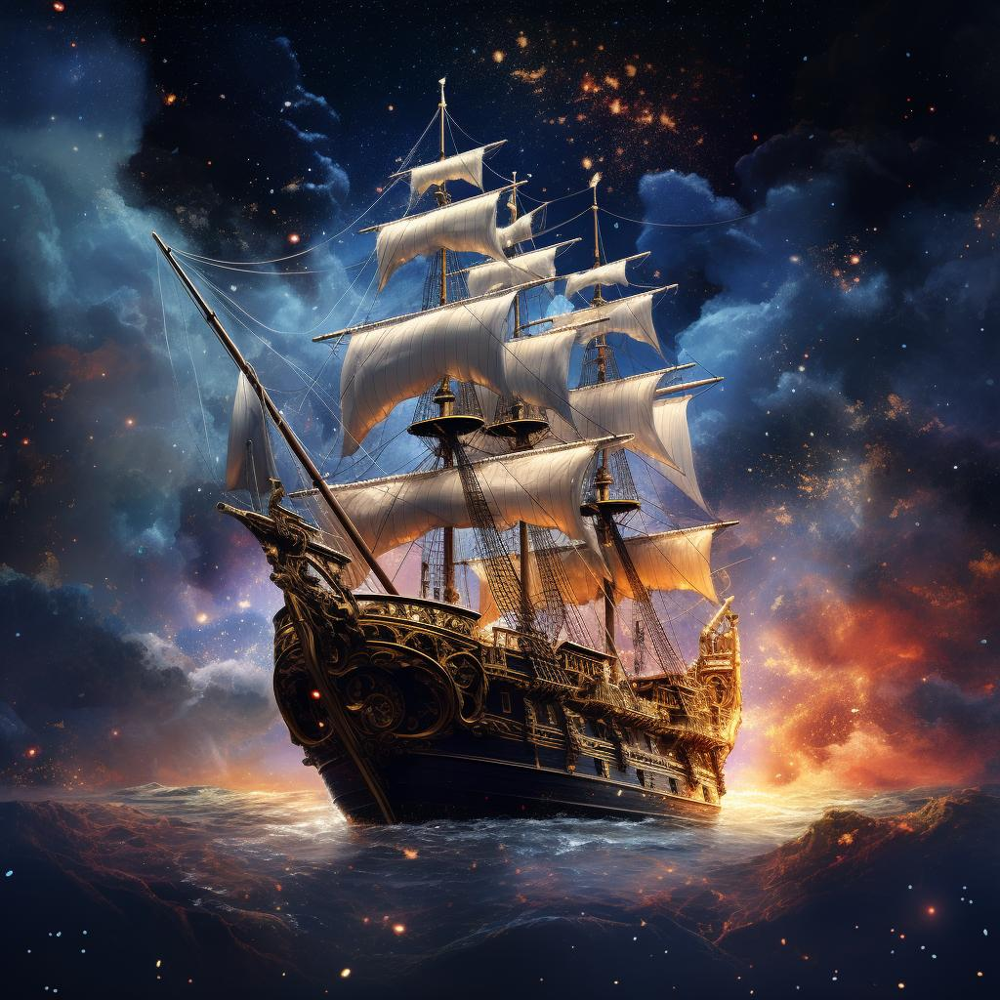

In [ ]:
from PIL import Image
# Define the path of your image
image_path = "/content/ship_in_galaxy.jpg"
# Open the image
image = Image.open(image_path)
image

### Gen-2: Make this ship sail the sea.




In [ ]:
!curl -L https://raw.githubusercontent.com/Denis2054/Transformers_3rd_Edition/master/Chapter19/ship_in_galaxy.mp4 --output "ship_in_galaxy.mp4"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3466k  100 3466k    0     0  5468k      0 --:--:-- --:--:-- --:--:-- 5468k


In [ ]:
from moviepy.editor import *
# Load myHolidays.mp4 and select the subclip 00:00:00 - 00:00:60
clip = VideoFileClip("ship_in_galaxy.mp4").subclip(00,7)
clip = clip.loop(5)
clip.ipython_display(width=900)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
